In [1]:
using thesis
using StatsPlots
using PRMaps
using PyCall
using Healpix
using Random, Distributions
using LinearAlgebra
using StructArrays

import Stripeline as Sl

In [2]:
a = Instrument(name = "cbass", frequency = 5.0, noisePerPixel = 72.0)
b = Instrument(name = "quijote_11", frequency = 11.0, noisePerPixel = 64.0)
c = Instrument(name = "quijote_13", frequency = 13.0, noisePerPixel = 90.0)
d = Instrument(name = "LSPE/Strip", frequency = 43.0, noisePerPixel = 1.8)

instruments = StructArray([a,b,c,d])

4-element StructArray(::Vector{String}, ::Vector{Float64}, ::Vector{Float64}) with eltype Instrument:
 Instrument("cbass", 5.0, 72.0)
 Instrument("quijote_11", 11.0, 64.0)
 Instrument("quijote_13", 13.0, 90.0)
 Instrument("LSPE/Strip", 43.0, 1.8)

In [3]:
nside = 64

cam_ang = Sl.CameraAngles()
 
setup = PRMaps.Setup(
    sampling_freq_Hz = 100,
    total_time_s = 24. * 3600. * 2.
    )
nothing

# Run simulation without the error

In [4]:
result = run_simulation(instruments, cam_ang, setup, nside)

┌ Info: Generating sky signal using pysm3
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:183
┌ Info: Simulating telescope scanning strategy [LSPE/Strip]
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:186


┌ Info: Adding white noise based on the instruments sensitivity
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:189
┌ Info: Run component separation using fgbuster
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:194


Dict{Any, Any} with 18 entries:
  "nit"       => 6
  "x"         => [1.58685, 20.0001, -3.00001]
  "hess_inv"  => [0.41072 -0.00130955 -8.45885e-5; -0.00130955 0.999997 -1.7228…
  "chi_dB"    => [[-1.6375e30 -1.6375e30 … -1.6375e30 -1.6375e30; -1.6375e30 -1…
  "nfev"      => 9
  "status"    => 2
  "chi"       => [-1.6375e30 -1.6375e30; -1.6375e30 -1.6375e30; -1.6375e30 -1.6…
  "s"         => [-1.6375e30 -1.6375e30; -1.6375e30 -1.6375e30; -1.6375e30 -1.6…
  "njev"      => 9
  "mask_good" => Bool[0, 0, 0, 0, 0, 0, 0, 0, 0, 0  …  0, 0, 0, 0, 0, 0, 0, 0, …
  "success"   => false
  "params"    => ["Dust.beta_d", "Dust.temp", "Synchrotron.beta_pl"]
  "fun"       => -6.57643e10
  "Sigma"     => [2.11062e15 -9.94683e17 4.18757e-6; -9.94683e17 4.68769e20 -0.…
  "message"   => "Desired error not necessarily achieved due to precision loss."
  "Sigma_inv" => [3.51099 0.00745 5239.7; 0.00745 1.58082e-5 11.1181; 5239.7 11…
  "jac"       => [-4.02638e-6, -8.54615e-9, 0.000709642]
  "invAtNA"   => [0.

/home/matteo/.julia/packages/PyCall/ygXW2/src/pyeval.jl:39: RuntimeWarning: covariance is not positive-semidefinite.
  PyPtr, (PyPtr, PyPtr, PyPtr),


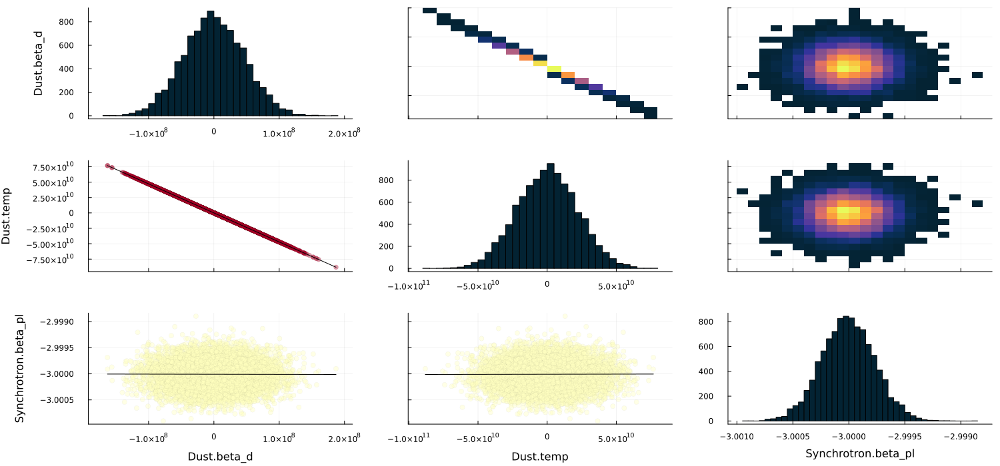

In [5]:
plot(get_corrplot(result))

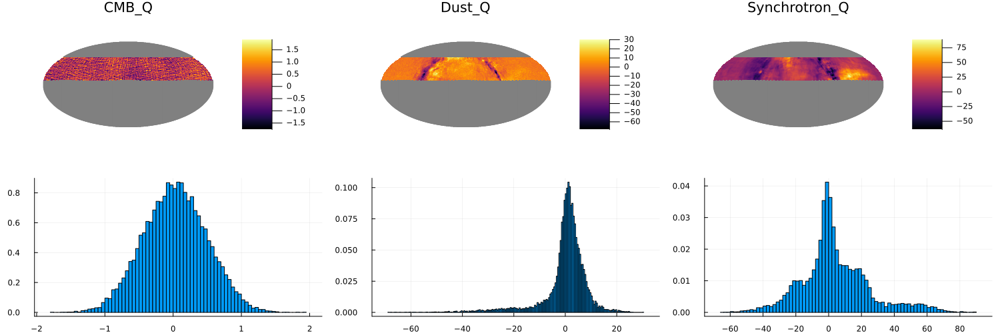

In [6]:
plot(get_map_and_hist(result, "Q", nside))

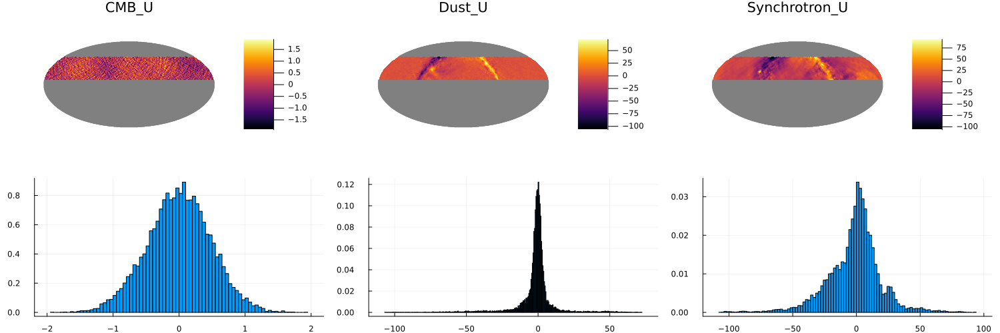

In [7]:
plot(get_map_and_hist(result, "U", nside))

# Run simulation with pointing error

In [9]:
tel_ang = Sl.TelescopeAngles(
    wheel2ang_0_rad = deg2rad(1.0)
)
nothing

In [10]:
result_with_error = run_simulation_with_error(instruments, cam_ang, tel_ang, setup, nside)

┌ Info: Generating sky signal using pysm3
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:214
┌ Info: Simulating telescope scanning strategy [LSPE/Strip WITH pointing error]
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:218


┌ Info: Adding white noise based on the instruments sensitivity
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:226
┌ Info: Run component separation using fgbuster
└ @ thesis /mnt/sda1/Università/Magistrale/Tesi/thesis/src/thesis.jl:231


Dict{Any, Any} with 18 entries:
  "nit"       => 15
  "x"         => [10.1764, 12.6101, -2.99977]
  "hess_inv"  => [1.03633 -1.02249 -0.000100058; -1.02249 2.05131 0.000122656; …
  "chi_dB"    => [[-1.6375e30 -1.6375e30 … -1.6375e30 -1.6375e30; -1.6375e30 -1…
  "nfev"      => 52
  "status"    => 2
  "chi"       => [-1.6375e30 -1.6375e30; -1.6375e30 -1.6375e30; -1.6375e30 -1.6…
  "s"         => [-1.6375e30 -1.6375e30; -1.6375e30 -1.6375e30; -1.6375e30 -1.6…
  "njev"      => 40
  "mask_good" => Bool[0, 0, 0, 0, 0, 0, 0, 0, 0, 0  …  0, 0, 0, 0, 0, 0, 0, 0, …
  "success"   => false
  "params"    => ["Dust.beta_d", "Dust.temp", "Synchrotron.beta_pl"]
  "fun"       => -6.57643e10
  "Sigma"     => [5.34472e23 2.28524e24 -2398.73; 2.28524e24 9.77099e24 -10255.…
  "message"   => "Desired error not necessarily achieved due to precision loss."
  "Sigma_inv" => [1.64724e-8 -3.85258e-9 0.0737498; -3.85258e-9 9.01041e-10 -0.…
  "jac"       => [-0.0597621, 0.0139772, -70.0511]
  "invAtNA"   => [0.596

/home/matteo/.julia/packages/PyCall/ygXW2/src/pyeval.jl:39: RuntimeWarning: covariance is not positive-semidefinite.
  PyPtr, (PyPtr, PyPtr, PyPtr),


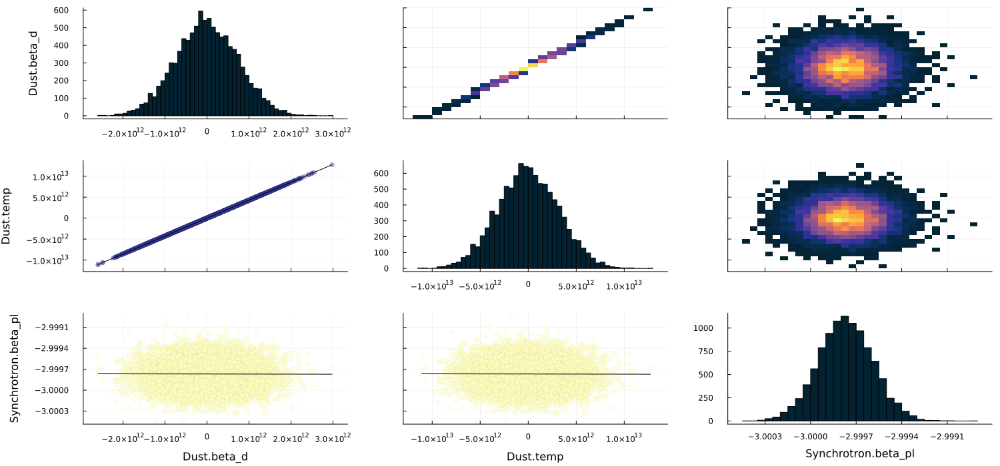

In [11]:
plot(get_corrplot(result_with_error))

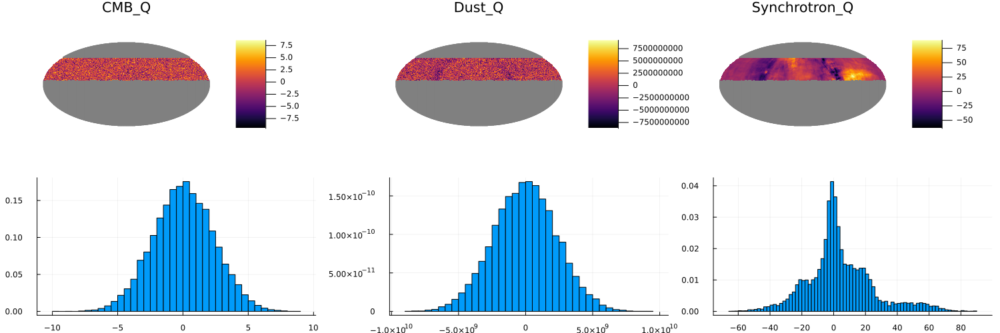

In [12]:
plot(get_map_and_hist(result_with_error, "Q", nside))

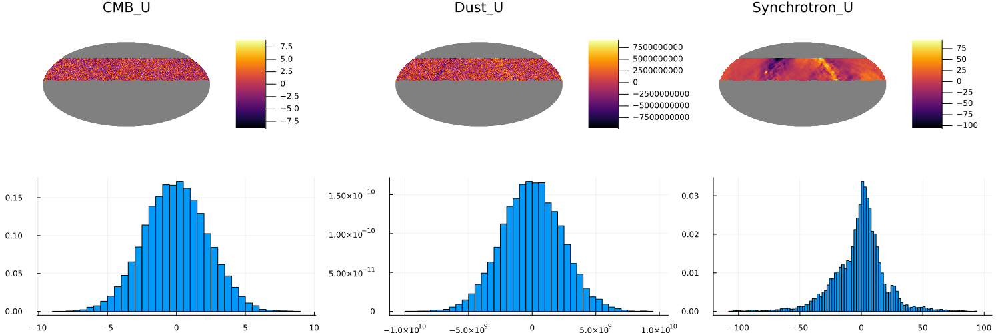

In [13]:
plot(get_map_and_hist(result_with_error, "U", nside))

# Compare covariance matix

In [15]:
result["Sigma"]

3×3 Matrix{Float64}:
  2.11062e15   -9.94683e17   4.18757e-6
 -9.94683e17    4.68769e20  -0.0416667
  0.000133771  -0.102736     5.64372e-8

In [16]:
result_with_error["Sigma"]

3×3 Matrix{Float64}:
     5.34472e23       2.28524e24   -2398.73
     2.28524e24       9.77099e24  -10255.7
 -2401.42        -10267.1              3.16523e-8